#Textual Embeddings for Specific Use Cases of Diffusion Models

[Colab Link](https://colab.research.google.com/drive/1swJf1dqd_cgkXV3CqVK5mEgXLrVTY3CE?usp=sharing)

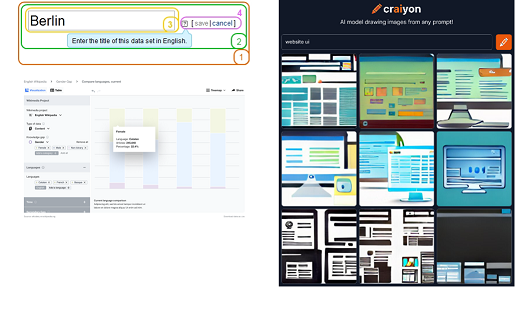

Figure 1. UI interface designs that demonstrate the intended image for a mockup. (Left) "Website UI" as generated by craiyon (formerly DALL-E Mini), focusing on generating computer monitors instead of the intended subject (Right)

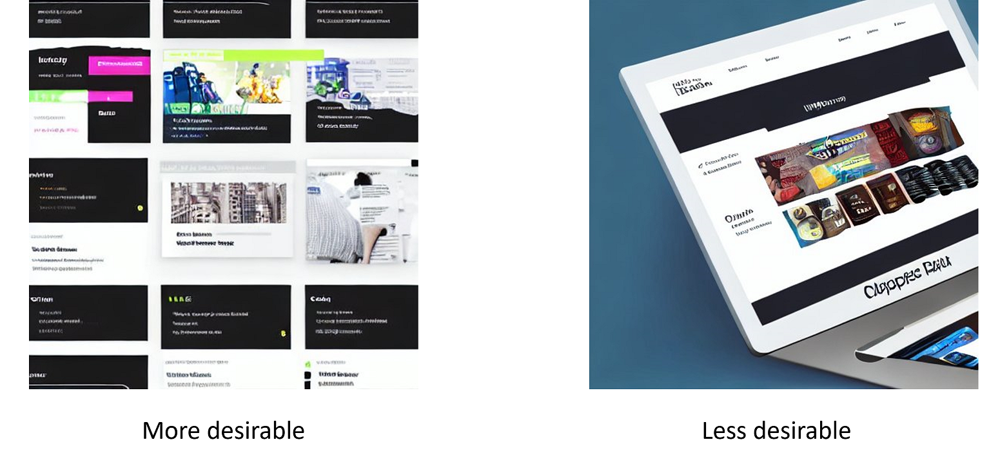

Figure 2. Stable diffusion generations of "website UI". Left is a more desirable generation focusing on the UI itself, while Right is less desirable generation in which the image of a computer detracts from the intended use case by cutting off a corner of the prototyped screen and showing the entire UI at an angle.



#Introduction


  The recent developments in image generation models like Dall-E, MidJourney, and StableDiffusion have led to people exploring if they can be used for purposes such as generating prototype UI components and concept art for fictional characters. However, there are limitations to a model that has not been trained beyond its base configuration. As seen in Figure 1, a model might generate extraneous, incorrect, or unhelpful features that may not fit a user's intended use case (in this case, generating a mockup of a website UI). The result is that a user may waste additional time trying to find a suitable prompt to have the AI model generate their desired content, or give up on using the model entirely.  We attempt to train a text embeddings for individual UI components and concepts a user might specifically want to see in Stable Diffusion to determine whether it would be possible to generate a modular series of components that could be added or removed in prototyping a website as needed.


  
  For my final project, I attempted to implement and train a Stable Diffusion model with the following objectives:

  1) To create an implementation of Stable Diffusion that would train specifically on UI element or web design images, and qualitatively assess the success of the results. As mentioned above, the goal is to help a user specifically prototype website UI or similar design elements (e.g. app icons). 

  2) To create a Google Colab notebook that would be accessible by an interested user looking to prototype UI images without being limited by their device or budget. A graphic designer may be working off a device like a notebook or similar that lacks the necessary GPUs to run an AI model like Stable Diffusion offline - our interest lies in making sure this is not a limitation for them so that they can quickly prototype UI designs for further personal and professional use. Furthermore, Google Colab space and GPU memory is extremely limited, both by the GPU itself and Google's own usage limits. This creates two issues - one, large ML models such as Stable Diffusion may not be able to run and two, any moderately long use of it can cause a session to be terminated prematurely due to the usage limit, costing the user any image output or trained embeddings they might have been generating.


  2) To understand how the implementation of Stable Diffusion and similar computer vision models works from a practical standpoint. I hoped to gain a better understanding of txt2img models as they are a large part of ongoing computer vision research.

  The report portion of this colab notebook will primarily be split into  sections that comment on each step of the process. This consists of a segment at the beginning that covers the research done in selecting the model and selecting/processing the dataset, indiviudal sections to comment on specific aspects of Stable Diffusion I learned while attempting this implementation, and a closing section after the code that demonstrates and discusses the results, issues, and next steps such a project could take.


**Model and Dataset Research** 

 A recurring problem in previous approaches to the txt2img and image generation problems primarily motivated by GANs was having to deal with complex networks or flawed generations with a large number of image artifacts [1]. Without additional implementations to guide it on a specific topic, GANs struggled to capture context specific information such as limb segmentation and even more general problems such as separating foreground and background objects from each other. As a result, GAN based models could not generalize well and a new implementation had to be built for each specific problem. 
 
 In 2021, OpenAI released the DALL-E txt2img model, which demonstrated that when trained with large amounts of data, a sufficeintly robust machine learning model could successfully translate text tokens to images. This is accomplished via the use of transformers, which used stacked encoders and decoders to impelment multi-head attention, which concatenates successive scores based on an input sequence to determine the context of a word at any given position relative to any other words [2]. DALL-E first uses a variable autoencoder to perform dimensionaltiy reduction by compressing 256x256 images to 32x32 grids of tokens representing the image [1]. Then, a transformer is passed  text tokens embeddings and the image tokens embeddings to generate hidden states result in an RGB cahnnel distribution of what the expected image should look like. The result generalizes well and is applicable to a wide variety of images. 
 
 However, one of the biggest challenges regarding models like DALL-E is that their developers typically do not release the source code for their models, which can limit accessibility because the model cannot be run offline or in any desired context, only through appropriate apps and cloud services. We thus turn to StableDiffusion, which was released in 2022 by Rombach et al. The model consists of the following components:

1) A language model such as BERT that takes a string and breaks it down into tokens. This model is typically frozen as we have no interest in training on it

2) A UNet that is a stacked series of Resnet blocks that performs dimensionality reduction on the corresponding image. It also generates and repeatedly denoises the image as it processes it in relation to the text tokens it was given.

3) A VAE Decoder that decodes the image representation to generate the final image.
[3]

This  transformer based architecture is reliant on using text embeddings to generate and denoise an image into a specific result based on a learning a Reverse Markov Chain [3]. We can take advantage of this by training a new word token embedding that corresponds to a new set of images such as app icons or website GUI that we then use in conjunction with the model. If trained correctly, the model should able to incorporate the new token into its probability distributions and denoise accordingly.

One other notable aspect of Stable Diffusion observed by Rombach et. al is that becuause the Unet is biased towards denoising an image with similar relevant context (aka inductive bias), this lets Stable Diffusion use more 2D convolution layers (which are less comutationallty intensive) as opposed to transformers [3].

**References**

1) Ramesh A, Pavlov M, Goh G, Gray S, Voss C, Radford A, Chen M, Sutskever I. Zero-shot text-to-image generation. InInternational Conference on Machine Learning 2021 Jul 1 (pp. 8821-8831). PMLR.

2) Vaswani A, Shazeer N, Parmar N, Uszkoreit J, Jones L, Gomez AN, Kaiser Ł, Polosukhin I. Attention is all you need. Advances in neural information processing systems. 2017;30.

3) Rombach R, Blattmann A, Lorenz D, Esser P, Ommer B. High-resolution image synthesis with latent diffusion models. InProceedings of the IEEE/CVF Conference on Computer Vision and Pattern Recognition 2022 (pp. 10684-10695).


#Setup and Attribution

https://huggingface.co/docs/diffusers/training/text_inversion

https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/sd_textual_inversion_training.ipynb

https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/stable_conceptualizer_inference.ipynb

https://huggingface.co/blog/stable_diffusion 

https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/stable_diffusion.ipynb

We use the tutorials and corresponding colab notebooks provided by the HuggingFace documentation of Stable Diffusion and similar models to setup this Colab Notebook. The objective was to make a simple Stable Diffusion pipeline and train on at least 200 images to produce a text embedding that would correspond to the UI component(s) we trained the model on. More specific code attribution has been provided where needed.


**Alternative implementations:**

https://huggingface.co/blog/dreambooth

https://rentry.org/sdstyleembed

We also considered using the Dreambooth training scripts and the AUTOMATIC1111 implementation of Stable Diffusion for training. We decided not to use the Dreambooth model due to it being specialized on training on a few select images and needing a lot of hyperparameter adjustment to avoid overfitting. It is also possible to fine tune the encoder, but that requires more memory (which is a concern we are trying to avoid for the purposes of this work.)

The AUTOMATIC1111 implementation is designed to be more user friendly but comes at the expense of long initial setup time and reduced controls over the training process for ease of use by users not familliar with programming. We choose using base Stable Diffusion in order to have fine grained control over our model with a proper dataset. We rejected DALL-E as our model for similar reasons earlier as it would be ideal for users to be able to freely pull and modify this setup as they wished in an environment.

#Dataset Selection

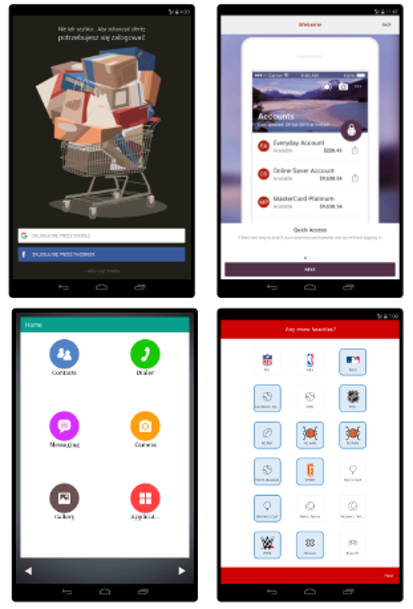

Figure 3. - Some ui5k screenshots

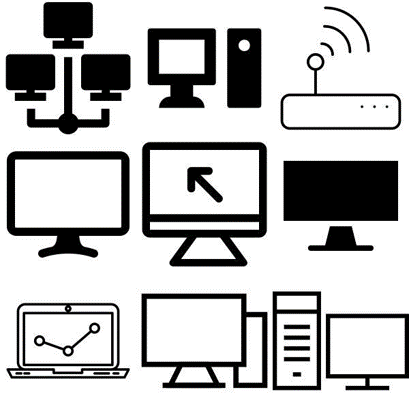

Figure 4. - Some Common Mobile/Web App Icons app icons from the Computers category.

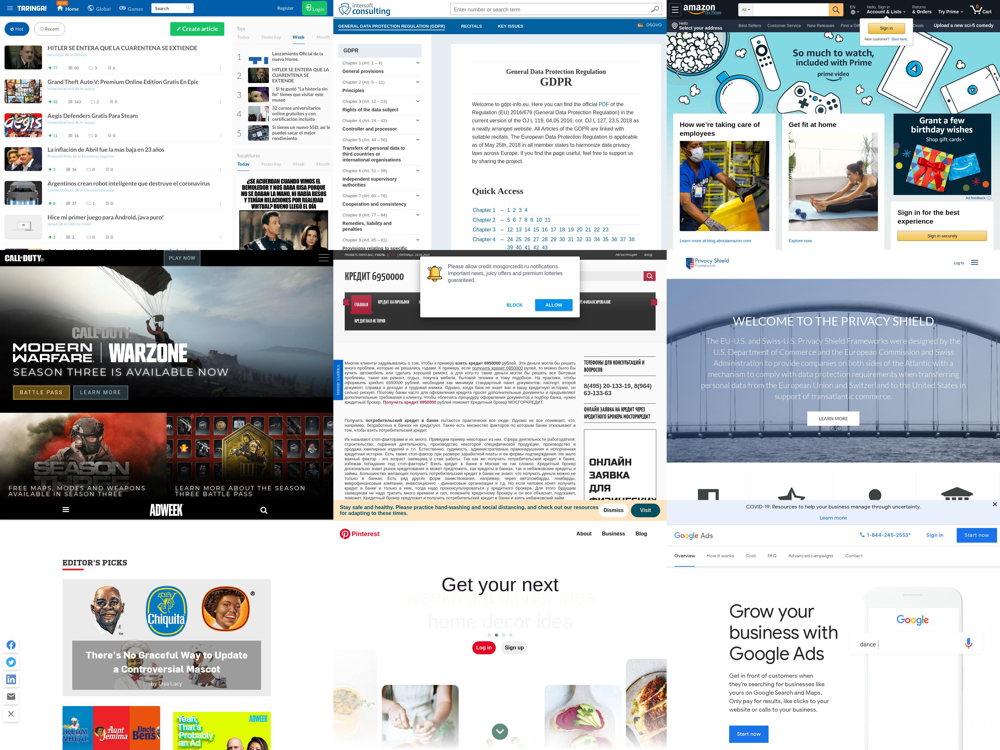

Figure 5. Some Website Screenshots images



https://paperswithcode.com/dataset/ui5k

Our initial dataset was a large dataset of 54,987 UI screenshots from 7748 Android applications. After some initial review of the dataset, this was rejected due to being too broad of a dataset as the screenshots greatly varied and made it hard to decide on a specific subset of the data to use for training for a specific UI element.


https://www.kaggle.com/datasets/colinmorris/favicons 

We then turned to datasets focused on specific app icons - favicons was rejected due to having a large tail of unconventionally sized images and potentially misclassified images as mentioned by the dataset maker, as well as having a large variety of differently sized square images that brought up the concern that a 16x16 image scaled up would be considerably blurier than a 64x64 image. This would have required too much manual preprocessing to identify bad images compared to the datasets below.

https://www.kaggle.com/datasets/danhendrycks/icons50

We considered this dataset of .ico files that featured icons from popular software companies like Apple and Google, but rejected it as the images were more geared towards emojis used in text conversations than app icons for a web developer trying to prototype. Additionally, we would have had to externally preprocess the images from icos to jpgs, which would have taken additional time.

**Training Dataset 1 - Common Mobile/Web App Icons**

https://www.kaggle.com/datasets/testdotai/common-mobile-web-app-icons

We settled on this kaggle dataset of 200x200 application image icons for our first training experiment as all images were appropriately categorized with the intention of refererring to concepts such as call icons or computers that web developers would practically use in their apps or prototypes. The main concerns were a few non-square images that were easilly eliminated through manually looking through a labled folder of images and removing them. We selected 200 appropriate random samples from the "computers" subset of images and used them for our first training set.

**Training Dataset 2 - Website Screenshots**

https://www.kaggle.com/datasets/destiny164o/website-screenshots

Following the general issues of our first training experiment, we reviewed datasets we had previously looked over and found this website screenshots dataset with 1085 training/validation screenshots of size  1024x768 of various popular websites, usually featuring a few key UI elements and images. We theorized that by introducing larger (but still relatively similar) images with a variety of desired UI elements, Stable diffusion would train to generate webpage mockups that could have a desired visual element of their choice inserted into them.

https://www.kaggle.com/datasets/splcher/animefacedataset 

https://www.kaggle.com/datasets/soumikrakshit/anime-faces

We also considered training on faces of anime-style cartoon characters as it is a common practice for mobile games to use a cropped square image of a cartoon character's face as an app icon. Due to a combination of a lack of time and the niche application of such a generation these datasets were not used, but could be used in a future experiment.




#Requirements

We install the required libraries in this section needed to run Stable Diffusion training and image generation.

For faster training, we may optionally utilize packages specific to https://github.com/TheLastBen/fast-stable-diffusion . 



In [ ]:
!pip install -U -qq git+https://github.com/huggingface/diffusers.git
!pip install -qq accelerate transformers ftfy
!pip install -qq "ipywidgets>=7,<8"

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done


In [ ]:
import argparse
import itertools
import math
import os
import random

import numpy as np
import torch
import torch.nn.functional as F
import torch.utils.checkpoint
from torch.utils.data import Dataset


import glob
import PIL
from accelerate import Accelerator
from accelerate.logging import get_logger
from accelerate.utils import set_seed
from diffusers import AutoencoderKL, DDPMScheduler, PNDMScheduler, StableDiffusionPipeline, UNet2DConditionModel
from diffusers.optimization import get_scheduler
from diffusers.pipelines.stable_diffusion import StableDiffusionSafetyChecker
from PIL import Image, ImageOps
from torchvision import transforms
from tqdm.auto import tqdm
from transformers import CLIPFeatureExtractor, CLIPTextModel, CLIPTokenizer
#Helper function provided by Huggingface for quick grid image display
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [ ]:
%%time

!pip install -U --pre triton

from subprocess import getoutput
from IPython.display import HTML
from IPython.display import clear_output
import time

s = getoutput('nvidia-smi')
if 'T4' in s:
  gpu = 'T4'
elif 'P100' in s:
  gpu = 'P100'
elif 'V100' in s:
  gpu = 'V100'
elif 'A100' in s:
  gpu = 'A100'

while True:
    try: 
        gpu=='T4'or gpu=='P100'or gpu=='V100'or gpu=='A100'
        break
    except:
        pass
    print('[1;31mit seems that your GPU is not supported at the moment')
    time.sleep(5)

if (gpu=='T4'):
  %pip install -q https://github.com/TheLastBen/fast-stable-diffusion/raw/main/precompiled/T4/xformers-0.0.13.dev0-py3-none-any.whl
  
elif (gpu=='P100'):
  %pip install -q https://github.com/TheLastBen/fast-stable-diffusion/raw/main/precompiled/P100/xformers-0.0.13.dev0-py3-none-any.whl

elif (gpu=='V100'):
  %pip install -q https://github.com/TheLastBen/fast-stable-diffusion/raw/main/precompiled/V100/xformers-0.0.13.dev0-py3-none-any.whl

elif (gpu=='A100'):
  %pip install -q https://github.com/TheLastBen/fast-stable-diffusion/raw/main/precompiled/A100/xformers-0.0.13.dev0-py3-none-any.whl

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
CPU times: user 71.9 ms, sys: 54 ms, total: 126 ms
Wall time: 10 s


In [ ]:
#huggingface login - Uncomment if needed for a given version of stable diffusion
#from huggingface_hub import notebook_login
#notebook_login()

#Memory Reduction

In the interest of letting users with any device or budget use this notebook, we perform some memory optimizations to minimize the impact of the strict Google Colab usage limits.

https://github.com/CompVis/stable-diffusion/issues/39

A common fix for memory issues is to set garbage collection threshold at 0.6 to minimize unused memory and limit max split size to prevent data fragmentation.

https://huggingface.co/CompVis/stable-diffusion-v1-4/tree/fp16
https://docs.nvidia.com/deeplearning/performance/mixed-precision-training/index.html

Additionally, we downgrade to Stable Diffusion 1.4, which has a dedicated fp16 branch. This is Stable Diffusion's half precision branch, which further reduces the memory requirements needed to run it on a setup such as Google Colab.

These optimizations allowed us to run in a context of a limited Free Google Colab GPU at a rate of about 30 minutes per 1000 epochs with minmal negative impact on generation quality.

In [ ]:
!export PYTORCH_CUDA_ALLOC_CONF=garbage_collection_threshold:0.6,max_split_size_mb:128

#Model

Our setup specifically works with stable diffusion 1.4 in order to pull the half precision branch but the user may manually input a different branch if desierd.

In [ ]:
#Our setup specifically works with stable diffusion 1.4 
pretrained_model_name_or_path = "CompVis/stable-diffusion-v1-4" 

#Image Directory Setup


Before continuing - please upload training images to the "train_images" directory created below.

In [ ]:
save_path = "./train_images"
if not os.path.exists(save_path):
  os.mkdir(save_path)
  #Upload Images after this setp

In [ ]:
!mv *.jpg ./train_images

In [ ]:
!ls ./train_images | wc -l

1084


#Setup and Check Images

A quick code snippet meant to check that the images for training were uploaded properly.

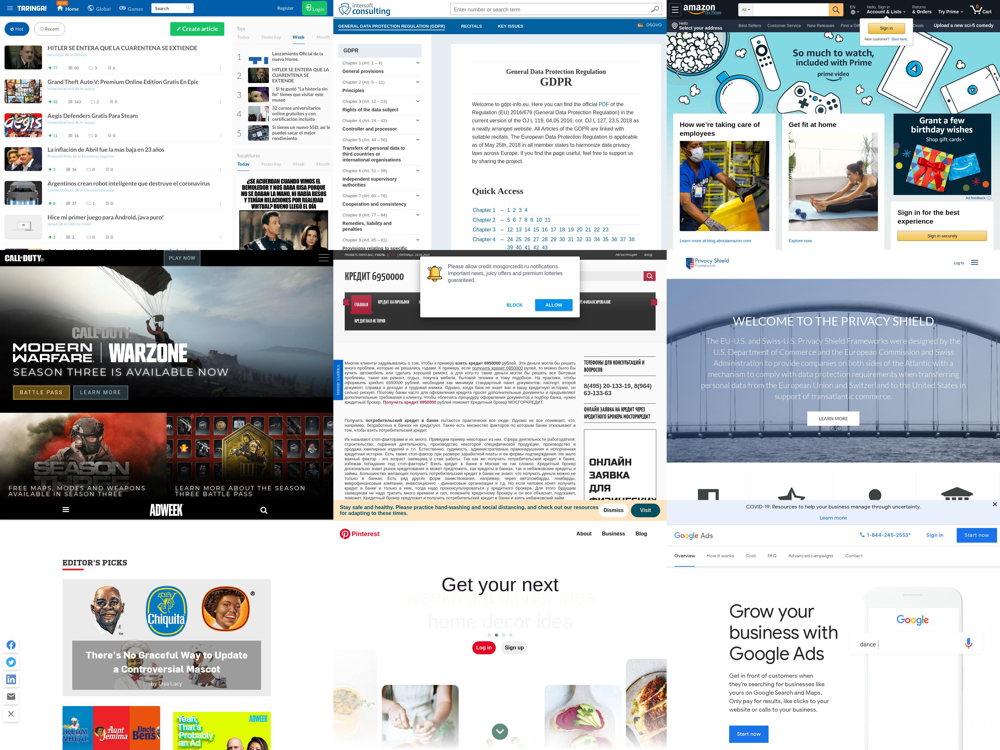

In [ ]:
#after uploading images:
#based on https://stackoverflow.com/questions/26392336/importing-images-from-a-directory-python-to-list-or-dictionary
image_list = []
for filename in glob.glob(save_path +'/*.jpg'): #assuming gif
    im=Image.open(filename)
    image_list.append(im)
image_sublist = image_list[:9]
#print(len(image_sublist))
image_grid(image_sublist, 3, 3)

In [ ]:
#descriptions provided by original tutorial
#modified for our custom tokens and terms

#We chose generic strings that would be difficult to confuse
#for other objectsl ike <ABC> or <XYZ>. In some of our early
#experiments the model accidentally broke down verbose tokens
#into their components e.g. <computer-application-icon>
#was broken down into its individual words and led to
#bad generations like images of music stars that were considered
#"icons" in the industry.

#<ABC> is website screenshots
#<XYZ> is application icons

#@title Token settings
#@markdown `what_to_teach`: what is it that you are teaching? `object` enables you to teach the model a new object to be used, `style` allows you to teach the model a new style one can use.
what_to_teach = "object" #@param ["object", "style"]
#@markdown `placeholder_token` is the token you are going to use to represent your new concept (so when you prompt the model, you will say "A `<my-placeholder-token>` in an amusement park"). We use angle brackets to differentiate a token from other words/tokens, to avoid collision.
placeholder_token = "\u003CABC>" #@param {type:"string"} ["\u003CXYZ>", "\u003CABC>"] {allow-input: true}
#@markdown `initializer_token` is a word that can summarise what your new concept is, to be used as a starting point
initializer_token = "website" #@param {type:"string"} ["symbol", "website"] {allow-input: true}




### Prompt Templates for Training 

We go with the generic templates provided by HuggingFace here as it is generally assumed they are ideal for training the model.

In [ ]:
#Setup the prompt templates for training 
imagenet_templates_small = [
    "a photo of a {}",
    "a rendering of a {}",
    "a cropped photo of the {}",
    "the photo of a {}",
    "a photo of a clean {}",
    "a photo of a dirty {}",
    "a dark photo of the {}",
    "a photo of my {}",
    "a photo of the cool {}",
    "a close-up photo of a {}",
    "a bright photo of the {}",
    "a cropped photo of a {}",
    "a photo of the {}",
    "a good photo of the {}",
    "a photo of one {}",
    "a close-up photo of the {}",
    "a rendition of the {}",
    "a photo of the clean {}",
    "a rendition of a {}",
    "a photo of a nice {}",
    "a good photo of a {}",
    "a photo of the nice {}",
    "a photo of the small {}",
    "a photo of the weird {}",
    "a photo of the large {}",
    "a photo of a cool {}",
    "a photo of a small {}",
]

imagenet_style_templates_small = [
    "a painting in the style of {}",
    "a rendering in the style of {}",
    "a cropped painting in the style of {}",
    "the painting in the style of {}",
    "a clean painting in the style of {}",
    "a dirty painting in the style of {}",
    "a dark painting in the style of {}",
    "a picture in the style of {}",
    "a cool painting in the style of {}",
    "a close-up painting in the style of {}",
    "a bright painting in the style of {}",
    "a cropped painting in the style of {}",
    "a good painting in the style of {}",
    "a close-up painting in the style of {}",
    "a rendition in the style of {}",
    "a nice painting in the style of {}",
    "a small painting in the style of {}",
    "a weird painting in the style of {}",
    "a large painting in the style of {}",
]

##Data Set Object

In [ ]:
#Setup the dataset
class TextualInversionDataset(Dataset):
    def __init__(
        self,
        data_root,
        tokenizer,
        learnable_property="object",  # [object, style]
        size=200, #this is dataset image size - sd images should be squares
        repeats=100, #default 100
        interpolation="bicubic",
        flip_p=0.5,
        set="train",
        placeholder_token="*",
        center_crop=False, #set to true if you want to quickly crop square images
    ):

        self.data_root = data_root
        self.tokenizer = tokenizer
        self.learnable_property = learnable_property
        self.size = size
        self.placeholder_token = placeholder_token
        self.center_crop = center_crop
        self.flip_p = flip_p

        self.image_paths = [os.path.join(self.data_root, file_path) for file_path in os.listdir(self.data_root)]

        self.num_images = len(self.image_paths)
        self._length = self.num_images

        if set == "train":
            self._length = self.num_images * repeats

        self.interpolation = {
            "linear": PIL.Image.LINEAR,
            "bilinear": PIL.Image.BILINEAR,
            "bicubic": PIL.Image.BICUBIC,
            "lanczos": PIL.Image.LANCZOS,
        }[interpolation]

        self.templates = imagenet_style_templates_small if learnable_property == "style" else imagenet_templates_small
        self.flip_transform = transforms.RandomHorizontalFlip(p=self.flip_p)

    def __len__(self):
        return self._length

    def __getitem__(self, i):
        example = {}
        image = Image.open(self.image_paths[i % self.num_images])

        if not image.mode == "RGB":
            image = image.convert("RGB")

        placeholder_string = self.placeholder_token
        text = random.choice(self.templates).format(placeholder_string)

        example["input_ids"] = self.tokenizer(
            text,
            padding="max_length",
            truncation=True,
            max_length=self.tokenizer.model_max_length,
            return_tensors="pt",
        ).input_ids[0]

        # default to score-sde preprocessing
        img = np.array(image).astype(np.uint8)

        if self.center_crop:
            crop = min(img.shape[0], img.shape[1])
            h, w, = (
                img.shape[0],
                img.shape[1],
            )
            img = img[(h - crop) // 2 : (h + crop) // 2, (w - crop) // 2 : (w + crop) // 2]

        image = Image.fromarray(img)
        image = image.resize((self.size, self.size), resample=self.interpolation)

        image = self.flip_transform(image)
        image = np.array(image).astype(np.uint8)
        image = (image / 127.5 - 1.0).astype(np.float32)

        example["pixel_values"] = torch.from_numpy(image).permute(2, 0, 1)
        return example

#Setup Model and Pipeline

Note "revision=fp16" here which tells pipeline component functions to pull from stablediffusion 1.4's half precision branch.

Here we select the other parts of our Stable Diffusion pipeline as described at the beginning of the paper - namely, the text encoder model we freeze, the UNet that will perform dimensionality reduction and noise distribution, and  VAE that will convert image representations generated by Unet back to images (as ouput) and vice versa (for input).

https://the-decoder.com/new-clip-model-aims-to-make-stable-diffusion-even-better/

As mentioned in https://github.com/CompVis/stable-diffusion CLIP is the default text encoder used in implementations of Stable Diffusion and Dall-E. Had time permitted we would've compared it with BERT (which is the text model used by the paper), but we did not have sufficient time to comapre the two.

If we want to create an entirely new text token and embedding for the model, we should use Appproach A. If we want to load a text token and embedding from an embedding file of a previous training session, we should use Approach B.

In [ ]:
#Load the Stable Diffusion model
# Load models and create wrapper for stable diffusion
# pipeline = StableDiffusionPipeline.from_pretrained(pretrained_model_name_or_path)
# del pipeline
#Load the tokenizer and add the placeholder token as a additional special token.
tokenizer = CLIPTokenizer.from_pretrained(
    pretrained_model_name_or_path,
    subfolder="tokenizer",
    revision="fp16"
)

text_encoder = CLIPTextModel.from_pretrained(
    pretrained_model_name_or_path, subfolder="text_encoder",
    revision="fp16"
)
unet = UNet2DConditionModel.from_pretrained(
    pretrained_model_name_or_path, subfolder="unet",
    revision="fp16"
)
vae = AutoencoderKL.from_pretrained(
    pretrained_model_name_or_path, subfolder="vae",
    revision="fp16"
)

Downloading:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/472 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/788 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/572 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/246M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/167M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/550 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/772 [00:00<?, ?B/s]

#Approach A - Make New Token and add to Tokenizer

Create a new token and embedding if you have no preexisting embedding to train.

In [ ]:
# Add the placeholder token in tokenizer
num_added_tokens = tokenizer.add_tokens(placeholder_token)
if num_added_tokens == 0:
    raise ValueError(
        f"The tokenizer already contains the token {placeholder_token}. Please pass a different"
        " `placeholder_token` that is not already in the tokenizer."
    )

In [ ]:
#prepares to insert next token-embedding pair

#Get token ids for our placeholder and initializer token. This code block will complain if initializer string is not a single token
# Convert the initializer_token, placeholder_token to ids
token_ids = tokenizer.encode(initializer_token, add_special_tokens=False)
# Check if initializer_token is a single token or a sequence of tokens
if len(token_ids) > 1:
    raise ValueError("The initializer token must be a single token.")

initializer_token_id = token_ids[0]
placeholder_token_id = tokenizer.convert_tokens_to_ids(placeholder_token)

#Approach B - Add uploaded embedding

Add existing uploaded embedding for more training/generation.

In [ ]:
learned_embeds_path = "./learned_embeds.bin"

In [ ]:
def load_learned_embed_in_clip(learned_embeds_path, text_encoder, tokenizer, token=None):
  loaded_learned_embeds = torch.load(learned_embeds_path, map_location="cpu")
  
  # separate token and the embeds
  trained_token = list(loaded_learned_embeds.keys())[0]
  embeds = loaded_learned_embeds[trained_token]

  # cast to dtype of text_encoder
  dtype = text_encoder.get_input_embeddings().weight.dtype
  embeds.to(dtype)

  # add the token in tokenizer
  token = token if token is not None else trained_token
  num_added_tokens = tokenizer.add_tokens(token)
  if num_added_tokens == 0:
    raise ValueError(f"The tokenizer already contains the token {token}. Please pass a different `token` that is not already in the tokenizer.")
  
  # resize the token embeddings
  text_encoder.resize_token_embeddings(len(tokenizer))
  
  # get the id for the token and assign the embeds
  token_id = tokenizer.convert_tokens_to_ids(token)
  text_encoder.get_input_embeddings().weight.data[token_id] = embeds
load_learned_embed_in_clip(learned_embeds_path, text_encoder, tokenizer)

In [ ]:
#prepares to insert next token-embedding pair

#Get token ids for our placeholder and initializer token. This code block will complain if initializer string is not a single token
# Convert the initializer_token, placeholder_token to ids
token_ids = tokenizer.encode(initializer_token, add_special_tokens=False)
# Check if initializer_token is a single token or a sequence of tokens
if len(token_ids) > 1:
    raise ValueError("The initializer token must be a single token.")

initializer_token_id = token_ids[0]
placeholder_token_id = tokenizer.convert_tokens_to_ids(placeholder_token)

#Post Approach A or B - Token Processing

Since we added a new token, we have to change the embedding vector to have an equivalent space for it.

In [ ]:
text_encoder.resize_token_embeddings(len(tokenizer))

Embedding(49409, 768)

Link token to embedding

In [ ]:
token_embeds = text_encoder.get_input_embeddings().weight.data
token_embeds[placeholder_token_id] = token_embeds[initializer_token_id]

#Setup Model Part 2

We freeze the parts of the network we don't intend to train here.

In [ ]:
def freeze_params(params):
    for param in params:
        param.requires_grad = False

freeze_params(vae.parameters())
freeze_params(unet.parameters())
params_to_freeze = itertools.chain(
    text_encoder.text_model.encoder.parameters(),
    text_encoder.text_model.final_layer_norm.parameters(),
    text_encoder.text_model.embeddings.position_embedding.parameters(),
)
freeze_params(params_to_freeze)

### Dataset and Data Loader

In [ ]:
train_dataset = TextualInversionDataset(
      data_root=save_path,
      tokenizer=tokenizer,
      size=vae.sample_size,
      placeholder_token=placeholder_token,
      repeats=100,
      learnable_property=what_to_teach,
      center_crop=False,
      set="train",
)

In [ ]:
def create_dataloader(train_batch_size=1):
    return torch.utils.data.DataLoader(train_dataset, batch_size=train_batch_size, shuffle=True)


https://huggingface.co/docs/diffusers/training/text_inversion

Stable Diffusion uses a scheduler algorithm to compute an image representation from the outputted Unet's noise output. 

https://huggingface.co/docs/diffusers/api/pipelines/ddim
https://huggingface.co/docs/diffusers/api/pipelines/pndm

Our initial plan was to compare DDIM and PNDIM schedulers to try and observe the peformance gap in time/epochs taken between the two. DDIM (denoising diffusion implicit models) schedulers were constructed to outperform denoising diffusion probabilistic models (DDPMs) schedulers by 10x to 50x speedup, while PNDIM (Pseudo Numerical methods for Diffusion Models on manifolds) replaced previous known numerical calculations used for DDIM with pseudo numerical calculations in order to perform an additional 20x speedup. However we ran into both time and usage limits from Google Colab during out DDIM experiments and had to conclude without repeating either of our datasets on PNDM-scheduled runs.

In [ ]:
noise_scheduler = DDPMScheduler.from_config(pretrained_model_name_or_path, subfolder="scheduler")

Downloading:   0%|          | 0.00/313 [00:00<?, ?B/s]

#Setup Model Part 3

### Hyper Parameters

In [ ]:
hyperparameters = {
    "learning_rate": 5e-04, #we experimented with this briefly and determined the tutorial's rate was ideal
    "scale_lr": True,
    "max_train_steps": 1000, #0 if you just want generation, 10 for a test run, 500 to test longer runs, 1000 for a full run
    "save_steps": 500, 
    "train_batch_size": 4,
    "gradient_accumulation_steps": 1,
    "gradient_checkpointing": True,
    "mixed_precision": "fp16", #requires GPU
    "seed": 42, #change seed for diff results
    "output_dir": "sd-concept-output"
}
!mkdir -p sd-concept-output

### Training

In [ ]:
logger = get_logger(__name__)

def save_progress(text_encoder, placeholder_token_id, accelerator, save_path):
    logger.info("Saving embeddings")
    learned_embeds = accelerator.unwrap_model(text_encoder).get_input_embeddings().weight[placeholder_token_id]
    learned_embeds_dict = {placeholder_token: learned_embeds.detach().cpu()}
    torch.save(learned_embeds_dict, save_path)

def training_function(text_encoder, vae, unet):
    train_batch_size = hyperparameters["train_batch_size"]
    gradient_accumulation_steps = hyperparameters["gradient_accumulation_steps"]
    learning_rate = hyperparameters["learning_rate"]
    max_train_steps = hyperparameters["max_train_steps"]
    output_dir = hyperparameters["output_dir"]
    gradient_checkpointing = hyperparameters["gradient_checkpointing"]

    accelerator = Accelerator(
        gradient_accumulation_steps=gradient_accumulation_steps,
        mixed_precision=hyperparameters["mixed_precision"]
    )

    if gradient_checkpointing:
        text_encoder.gradient_checkpointing_enable()
        unet.enable_gradient_checkpointing()

    train_dataloader = create_dataloader(train_batch_size)

    if hyperparameters["scale_lr"]:
        learning_rate = (
            learning_rate * gradient_accumulation_steps * train_batch_size * accelerator.num_processes
        )

    # Initialize the optimizer
    optimizer = torch.optim.AdamW(
        text_encoder.get_input_embeddings().parameters(),  # only optimize the embeddings
        lr=learning_rate,
    )

    text_encoder, optimizer, train_dataloader = accelerator.prepare(
        text_encoder, optimizer, train_dataloader
    )

    weight_dtype = torch.float32
    if accelerator.mixed_precision == "fp16":
        weight_dtype = torch.float16
    elif accelerator.mixed_precision == "bf16":
        weight_dtype = torch.bfloat16

    # Move vae and unet to device
    vae.to(accelerator.device, dtype=weight_dtype)
    unet.to(accelerator.device, dtype=weight_dtype)

    # Keep vae in eval mode as we don't train it
    vae.eval()
    # Keep unet in train mode to enable gradient checkpointing
    unet.train()

    
    # We need to recalculate our total training steps as the size of the training dataloader may have changed.
    num_update_steps_per_epoch = math.ceil(len(train_dataloader) / gradient_accumulation_steps)
    num_train_epochs = math.ceil(max_train_steps / num_update_steps_per_epoch)

    # Train!
    total_batch_size = train_batch_size * accelerator.num_processes * gradient_accumulation_steps

    logger.info("***** Running training *****")
    logger.info(f"  Num examples = {len(train_dataset)}")
    logger.info(f"  Instantaneous batch size per device = {train_batch_size}")
    logger.info(f"  Total train batch size (w. parallel, distributed & accumulation) = {total_batch_size}")
    logger.info(f"  Gradient Accumulation steps = {gradient_accumulation_steps}")
    logger.info(f"  Total optimization steps = {max_train_steps}")
    # Only show the progress bar once on each machine.
    progress_bar = tqdm(range(max_train_steps), disable=not accelerator.is_local_main_process)
    progress_bar.set_description("Steps")
    global_step = 0

    for epoch in range(num_train_epochs):
        text_encoder.train()
        for step, batch in enumerate(train_dataloader):
            with accelerator.accumulate(text_encoder):
                # Convert images to latent space
                latents = vae.encode(batch["pixel_values"].to(dtype=weight_dtype)).latent_dist.sample().detach()
                latents = latents * 0.18215

                # Sample noise that we'll add to the latents
                noise = torch.randn_like(latents)
                bsz = latents.shape[0]
                # Sample a random timestep for each image
                timesteps = torch.randint(0, noise_scheduler.num_train_timesteps, (bsz,), device=latents.device).long()

                # Add noise to the latents according to the noise magnitude at each timestep
                # (this is the forward diffusion process)
                noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

                # Get the text embedding for conditioning
                encoder_hidden_states = text_encoder(batch["input_ids"])[0]

                # Predict the noise residual
                noise_pred = unet(noisy_latents, timesteps, encoder_hidden_states.to(weight_dtype)).sample

                 # Get the target for loss depending on the prediction type
                if noise_scheduler.config.prediction_type == "epsilon":
                    target = noise
                elif noise_scheduler.config.prediction_type == "v_prediction":
                    target = noise_scheduler.get_velocity(latents, noise, timesteps)
                else:
                    raise ValueError(f"Unknown prediction type {noise_scheduler.config.prediction_type}")

                loss = F.mse_loss(noise_pred, target, reduction="none").mean([1, 2, 3]).mean()
                accelerator.backward(loss)

                # Zero out the gradients for all token embeddings except the newly added
                # embeddings for the concept, as we only want to optimize the concept embeddings
                if accelerator.num_processes > 1:
                    grads = text_encoder.module.get_input_embeddings().weight.grad
                else:
                    grads = text_encoder.get_input_embeddings().weight.grad
                # Get the index for tokens that we want to zero the grads for
                index_grads_to_zero = torch.arange(len(tokenizer)) != placeholder_token_id
                grads.data[index_grads_to_zero, :] = grads.data[index_grads_to_zero, :].fill_(0)

                optimizer.step()
                optimizer.zero_grad()

            # Checks if the accelerator has performed an optimization step behind the scenes
            if accelerator.sync_gradients:
                progress_bar.update(1)
                global_step += 1
                if global_step % hyperparameters["save_steps"] == 0:
                    save_path = os.path.join(output_dir, f"learned_embeds-step-{global_step}.bin")
                    save_progress(text_encoder, placeholder_token_id, accelerator, save_path)

            logs = {"loss": loss.detach().item()}
            progress_bar.set_postfix(**logs)

            if global_step >= max_train_steps:
                break

        accelerator.wait_for_everyone()


    # Create the pipeline using using the trained modules and save it.
    if accelerator.is_main_process:
        pipeline = StableDiffusionPipeline.from_pretrained(
            pretrained_model_name_or_path,
            text_encoder=accelerator.unwrap_model(text_encoder),
            tokenizer=tokenizer,
            vae=vae,
            unet=unet,
            revision="fp16"
        )
        pipeline.save_pretrained(output_dir)
        # Also save the newly trained embeddings
        save_path = os.path.join(output_dir, f"learned_embeds.bin")
        save_progress(text_encoder, placeholder_token_id, accelerator, save_path)

In [ ]:
#approsx 17min to run 500 steps
import accelerate
accelerate.notebook_launcher(training_function, args=(text_encoder, vae, unet))

for param in itertools.chain(unet.parameters(), text_encoder.parameters()):
  if param.grad is not None:
    del param.grad  # free some memory
  torch.cuda.empty_cache()

Launching training on one GPU.


  0%|          | 0/1000 [00:00<?, ?it/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

# Part 4 - Image Generations

In [ ]:
from diffusers import DPMSolverMultistepScheduler
pipe = StableDiffusionPipeline.from_pretrained(
    hyperparameters["output_dir"],
    scheduler=DPMSolverMultistepScheduler.from_pretrained(hyperparameters["output_dir"], subfolder="scheduler", revision="fp16"),
    torch_dtype=torch.float16,
    revision="fp16"
).to("cuda")

  0%|          | 0/30 [00:00<?, ?it/s]

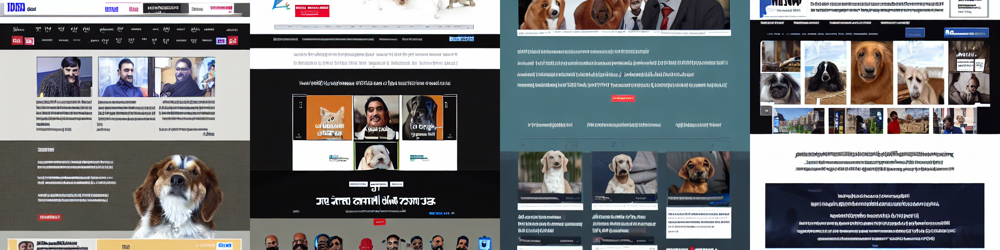

In [ ]:
#@title Stable Diffusion pipeline w/configurable parameters
#For app icons
#prompt = "an \u003CXYZ> on a bowl" #@param {type:"string"} ["an \u003CXYZ> on a bowl", "an \u003CXYZ> on a bottle", "an \u003CXYZ> on a computer screen", "an \u003CXYZ> on a phone", "an \u003CXYZ> on a website"]  {allow-input: true}
#for website screenshots
prompt = "a dog inside a \u003CABC>" #@param {type:"string"} ["a photo of a \u003CABC>", "a painting of a \u003CABC>", "a \u003CABC>", "a car inside a \u003CABC>", "a dog inside a \u003CABC>"]  {allow-input: true}
num_samples = 4 #@param {type:"number"}
num_rows = 1 #@param {type:"number"}

all_images = [] 
for _ in range(num_rows):
    images = pipe([prompt] * num_samples, num_inference_steps=30, guidance_scale=7.5).images
    all_images.extend(images)

grid = image_grid(all_images, num_rows, num_samples)
grid

#Results

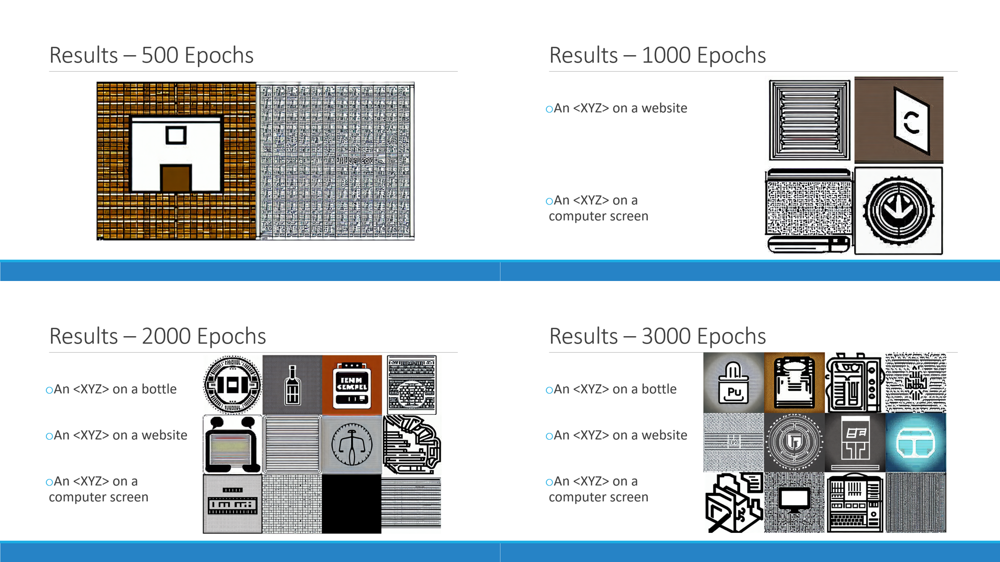

Figure 6. Generations for Common Mobile/Web App Icons training up to 3000 epochs

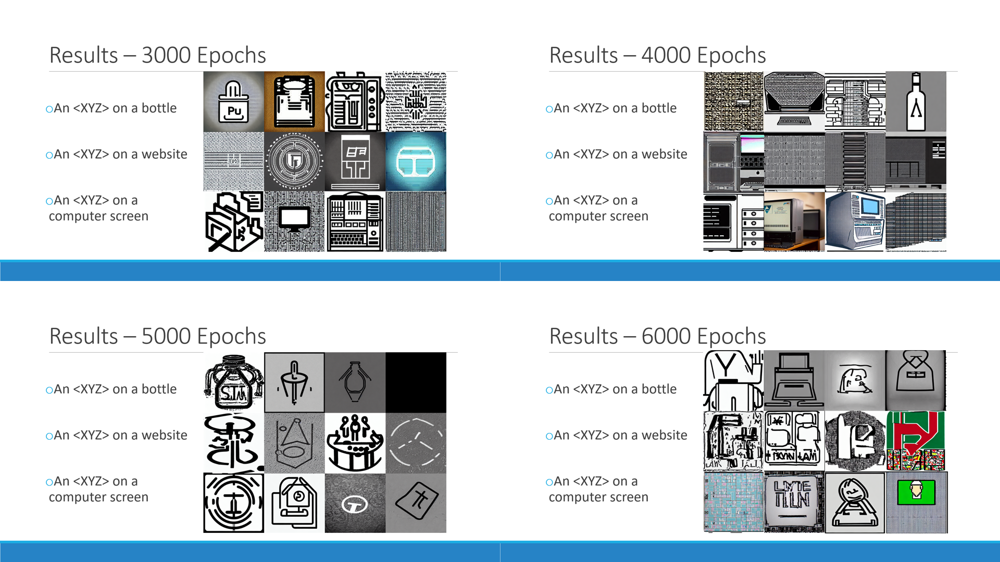

Figure 7. Generations for Common Mobile/Web App Icons training up to 6000 epochs

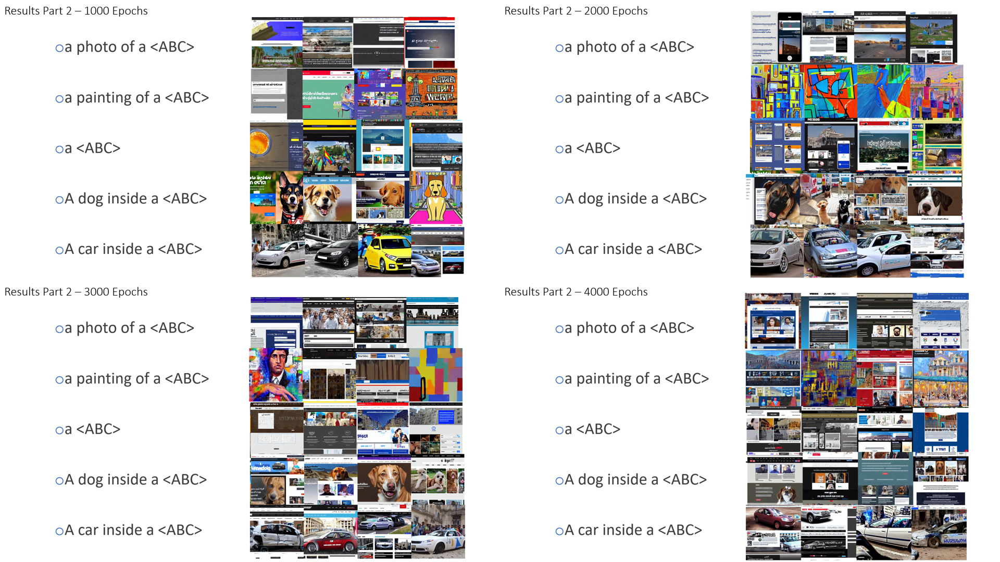

Figure 8. Generations for Website Screenshots Icons training up to 4000 epochs

Initially, Stable Diffusion appeared to quickly overfit to our Common Mobile/Web App Icons dataset.  Generations for the  first 3000 epochs were mostly extremely simplistic symbols that did not properly incorporate the presence of other terms such as "computer screen" or "website". (One of the exceptions, "bottle", is included here as a demonstration of Stable Diffusion correctly combining concepts by trying to place simplistic computer like symobls on images of a bottle). We tried adjusting the learning rate to see if this was the cause, but ultimately it appears the model was able to start genrealizing after training up to 6000 epochs, where very rough sytlistic mockups of websites and computer screens with rough symbols on them could be seen. (However, it would still need a large aomount of epochs before anything of acceptable quality would be generated.) We suspected that part of the problem was the ambiguity of the word "on", which did not explicitly indicate how a learned symbol would be placed relative to another object in the prompt.

Another issue that was common to this first experiment is that  generated images starting from epoch 2000 triggered Stable Diffusion's NSFW filter, which replaces any potentically inappropriate generations with a black square. While practically helpful, an increasing number of images inexplicably triggered this filter starting from epoch 5000 onwards, requiring us to generate many more images to get a decent number of images displayed in the results. We speculate that the model has either somehow accidentally overfit to generating crude symbolic or text emojis associated with inappropriate remarks, or that Stable Diffusion's NSFW filter is overzealous in this regard when handling slightly suspicious symbols. Unfortunately, we did not have time to repeat the experiment with the NSFW filter of and test this theory.

We decided to more throughly test our Website Screenshot experiment with differnet prompts to see if we could better identify the problem - this time, prompts explicitly based on the training prompt pool such as "a photo of a \<ABC>" were included alongside more explicitly logical prompts such as "a dog inside a \<ABC>". We also generated the \<ABC> by itself to track how well Stable Diffusion was learning it. However, the Website Screenshots dataset performed considerably better in all instances, consistently generating websites with any desired element or style by epoch 3000. It is likely that the cause for the overfitting in our first experiment was the extremely low resolution and low color variance of our source images combined with a relatively small training datatset. Due to the simplistic design of the Common Mobile/WebApp Icons datatset, most icons are black and white images with no intermediate grayscale values, but the shapes of the icons vary enough (consider a computer monitor icon vs an icon of a laptop vs an icon of a desktop computer) that Stable Diffusion was only able to vaguely learn how to denoise the images to form low resolution black and white symbols in the time it had available. We observe that as Stable Diffusion is reliant on inductive bias to more effciently complete images, it likely was not able to bias towards any values in any noise matrices that corresponded consistently to features corresponding to a computer icon [3].

On the other hand, most websites explicitly design their UI elements in a way that they stand out from the background colors of a web page. This likely meant that when translated to a matrix of noise values, there was a consistent difference in cells that possesseed a UI element and cells that did not. Stable Diffusion was clearly able to learn how to generate web ui icons relative to other features or stylistic demands of a hypothetical website mockup as a result and consistently genrated images solely featuring website mockups up the desires element(s) with a clear differenation between the website UI background, the website UI elements, and any additional elements (e.g. an image of a dog) we wanted added in. We observe that when Stable Diffusion is able to use its inductive bias properly, it can quickly learn to generate images for a speific use case without overfitting. We believe that having a high quality image dataset with consistent learnable features (e.g. UI elements explicitly distinct from website background) is important for Stable Diffusion to quickly determine how to use trends among the dat to solve the prolbem.

As mentioned throughout the notebook, a combination of time and Google Colab usage restrictions prevented further experimentation. We could likely try and select more app icon data and/or augment it with aspects like changing color or rotation to try and see if that helps Stable Diffusion learn the app icon dataset quicker or more slowly, as well as try different schedulers to measure training time efficiency or different text encoders like BERT to determine if it affects the quality of images generated. 

Lastly, a lot of time was also spent determining which memory optimizations should be implemented due to larger versions of Stable Diffusion not being viable to run on a free Google Colab. In the future, I would start looking for half precision models or an equivalent right away where  possible, as well as seeing if garbage collection and if data split size should be adjusted accordingly.

This project also highlighted to me the importance of preprocessing a dataset, even if it is a data set you do not use yourself. Some of the data sets on Kaggle that were rejected  which were mentioned in this report involved  misclasified or unusuable data that could be not be eliminated easily with a given metric - this is especially a problem for images where uploading and performing operations on large batches of them can be  time consuming or inefficient without knowing the right tools. In the future I would likely seek out data sets that have been preprocessed more properly and have a better workflow on how to deal with extremely unorganized data if I have to use it for a given study.

**References**

1) Ramesh A, Pavlov M, Goh G, Gray S, Voss C, Radford A, Chen M, Sutskever I. Zero-shot text-to-image generation. InInternational Conference on Machine Learning 2021 Jul 1 (pp. 8821-8831). PMLR.

2) Vaswani A, Shazeer N, Parmar N, Uszkoreit J, Jones L, Gomez AN, Kaiser Ł, Polosukhin I. Attention is all you need. Advances in neural information processing systems. 2017;30.

3) Rombach R, Blattmann A, Lorenz D, Esser P, Ommer B. High-resolution image synthesis with latent diffusion models. InProceedings of the IEEE/CVF Conference on Computer Vision and Pattern Recognition 2022 (pp. 10684-10695).